In [106]:
import numpy as np
import torch
from Lib import *
import matplotlib.pyplot as plt
from scipy.stats import norm

In [107]:
x = return_dict('/gpfs/jlse-fs0/users/kraghavan/Inverse/inverse_data_interpolated_numpy.p')
print(x.keys())


dict_keys(['One_Peak_E', 'One_Peak_R', 'Two_Peak_R', 'Two_Peak_E', 'One_Peak_R_interp', 'Two_Peak_R_interp', 'tau', 'omega', 'omega_fine'])


In [6]:
tau = x['tau']
omega=x['omega']
omega_fine=x['omega_fine']

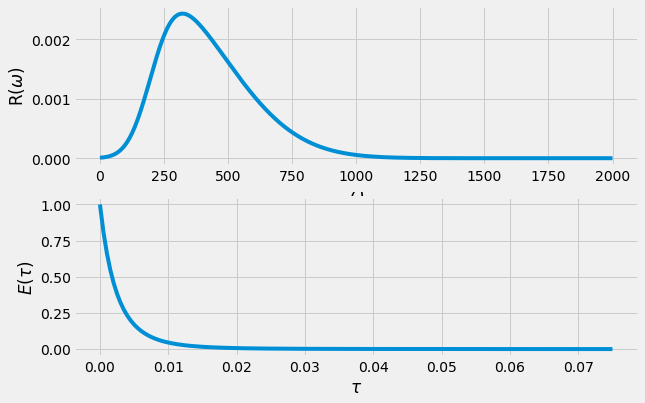

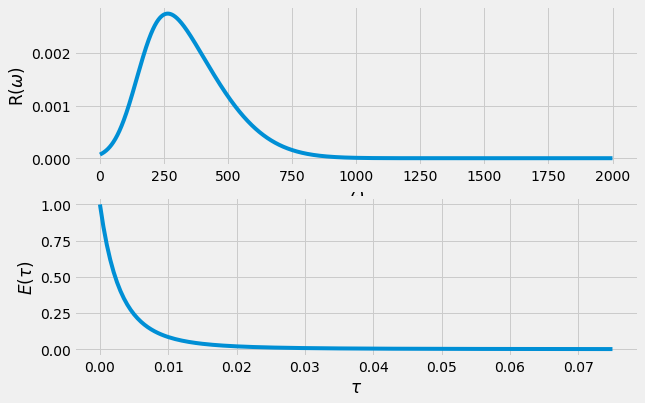

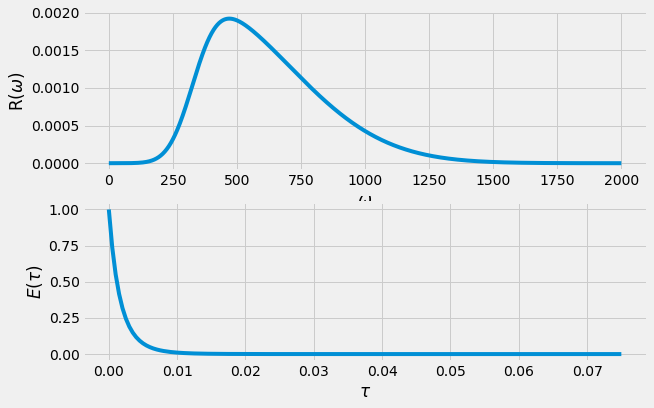

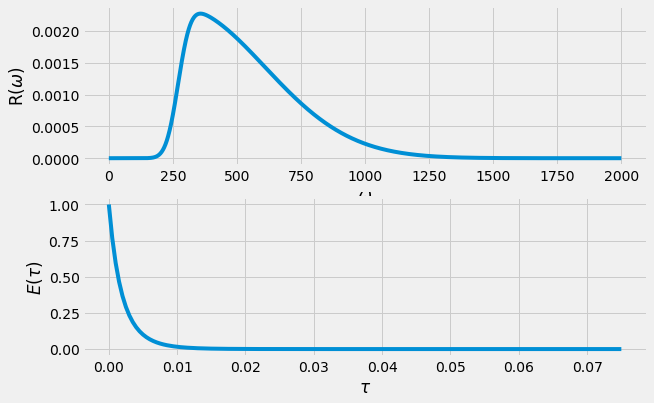

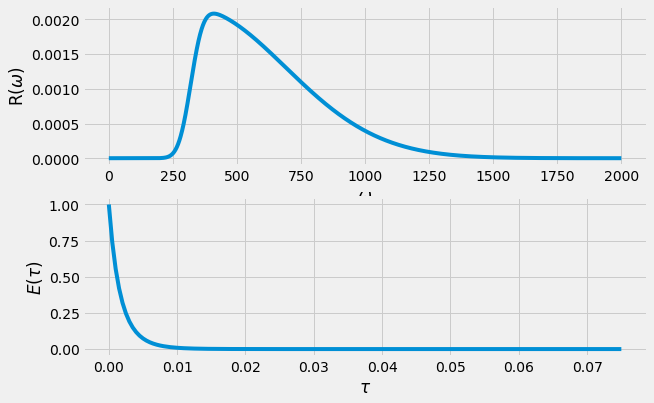

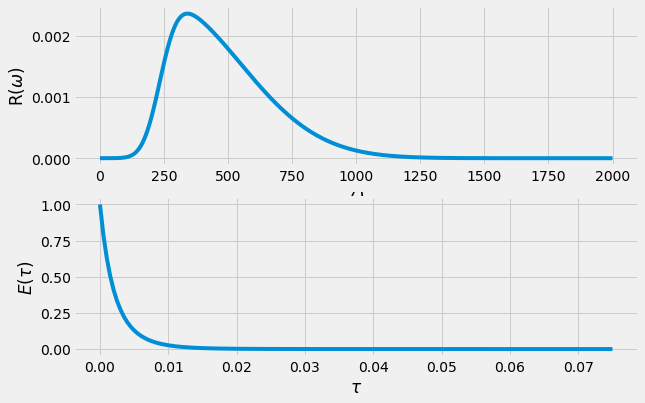

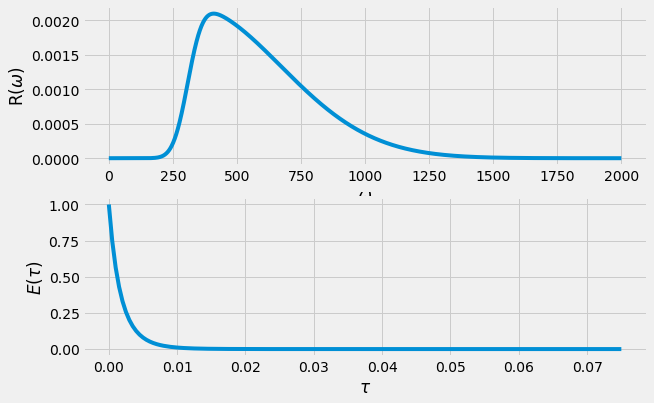

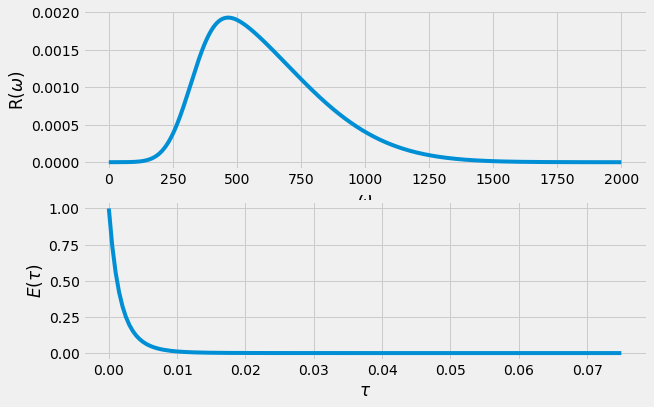

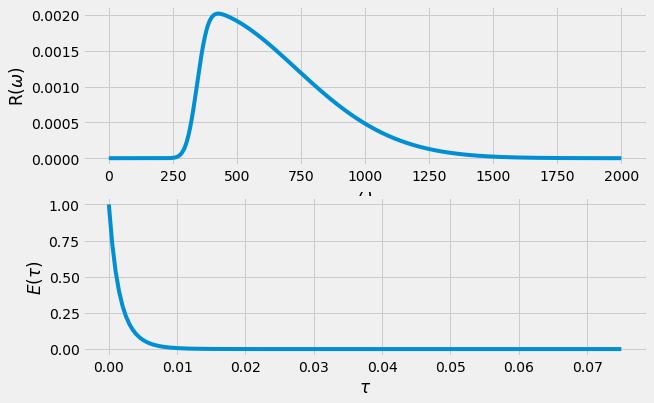

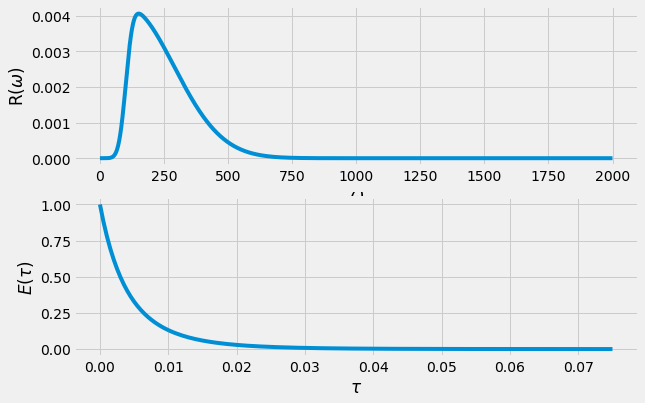

In [100]:
# build the plot
plt.style.use('fivethirtyeight')\
    
for i in range(10):
    k = np.random.randint(0,100000)
    fig, (ax1,ax2) =plt.subplots(2,1, figsize=(9,6))

    ax1.plot(omega_fine, R[k,:])
    ax1.set_xlabel('$\\omega$')
    ax1.set_ylabel('R($\\omega$)')
    
    ax2.plot(tau, E[k,:])
    ax2.set_xlabel('$\\tau$')
    ax2.set_ylabel('$E(\\tau$)')
    
    plt.show()

In [102]:
def Gauss(o, alpha, mu, sigma):
    import scipy
    return scipy.stats.skewnorm.pdf(o, alpha, mu,sigma)


In [105]:
R=np.zeros([1000000, 2000])
for i in range(1000000):    
    q = np.random.random()*700+100
    mu_QE=(q*q/(2*939.57) )+25
    sig_QE=(2*q*225)/939.57
    alpha=np.random.random()*10+2
    
    print("(mu, sigma)", mu_QE, sig_QE)
    R[i,:] = Gauss(omega_fine, alpha, mu_QE, sig_QE).reshape([1, -1])

    # build the plot
    #     fig, ax = plt.subplots(figsize=(9,6))
    #     plt.style.use('fivethirtyeight')
    #     ax.plot(omega_fine, R[i,:])
    #     ax.set_xlabel('$\\omega$')
    #     ax.set_yticklabels([])
    #     ax.set_title('R($\\omega$)')
    #     plt.show()

(mu, sigma) 192.27880459011214 268.52417996067845
(mu, sigma) 80.82888510127825 155.1287947792903
(mu, sigma) 31.12880886503998 51.398563288490266
(mu, sigma) 55.99255808436148 115.58238527135028
(mu, sigma) 246.91546745383675 309.28348305319736
(mu, sigma) 79.5626036365509 153.3594293352326
(mu, sigma) 108.7023697537411 189.946728385528
(mu, sigma) 218.98586192635554 289.1665012239763
(mu, sigma) 91.22782136886084 168.9597176921544
(mu, sigma) 195.05768430734383 270.74539045023613
(mu, sigma) 63.69267633352397 129.14491955264293
(mu, sigma) 112.09619858244969 193.75929290338425
(mu, sigma) 150.49042999729633 232.57779273634785
(mu, sigma) 79.61740691012145 153.43642794638765
(mu, sigma) 92.78086250180137 170.92928905870835
(mu, sigma) 93.5671651366747 171.91787640989867
(mu, sigma) 335.2292691135244 365.68262488948534
(mu, sigma) 33.70598598403283 61.25928487616004
(mu, sigma) 329.28426501639734 362.16184028782175
(mu, sigma) 61.30418428791901 125.09538337073836
(mu, sigma) 196.874967

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [108]:
print(R.shape)

(1000000, 2000)


In [109]:
tau = x['tau']
omega_ = x['omega']
omega_fine = x['omega_fine']
E, R, Kern, Kern_R = integrate(tau, omega_, omega_fine, R)
###################################################
Kern_R[:, (Kern_R.shape[1]-1)] = 1
###################################################
E = E.astype('float64')
R = R.astype('float64')

In [110]:
print(E.shape, R.shape)
normalizer=np.repeat(E[:,0].reshape([-1,1]),2000, axis=1)

(1000000, 151) (1000000, 2000)


In [111]:
R=R/normalizer

In [ ]:
E, R, Kern, Kern_R = integrate(tau, omega_, omega_fine, R)
###################################################
Kern_R[:, (Kern_R.shape[1]-1)] = 1
###################################################
E = E.astype('float64')
R = R.astype('float64')

In [ ]:
np.savez('/gpfs/jlse-fs0/users/kraghavan/Inverse/new_Data', E=E, R=R, tau=tau, omega=omega, omega_fine=omega_fine)